## Imports and Config

In [46]:
!pip install folium

In [47]:
%matplotlib inline

import pandas as pd
import numpy as np
from pathlib import Path
from pprint import pprint
from matplotlib import pyplot as plt
import folium
from folium import plugins

In [2]:
DATA_PATH = Path("../data")
all_csvs = list(DATA_PATH.glob("*.csv"))
pprint(all_csvs)

[WindowsPath('../data/hashtag_donaldtrump.csv'),
 WindowsPath('../data/hashtag_joebiden.csv')]


In [239]:
## Only pick these columns
USE_COLS = [
    'created_at', 'tweet', 'likes', 'retweet_count',
    'source', 'user_screen_name', 'lat',
    'long', 'country', 'state'
]

## Number of rows to include from each CSV
N_ROWS = 800000

## Loading the data

In [240]:
trump = pd.read_csv(all_csvs[0],nrows=N_ROWS,usecols=USE_COLS,lineterminator="\n")
biden = pd.read_csv(all_csvs[1],nrows=N_ROWS,usecols=USE_COLS,lineterminator="\n")
df = pd.concat([trump,biden])

In [241]:
df.shape

(1576886, 10)

In [242]:
df.head()

,created_at,tweet,likes,retweet_count,source,user_screen_name,lat,long,country,state
0,2020-10-15 00:00:01,#Elecciones2020 | En #Florida: #JoeBiden dice ...,0.0,0.0,TweetDeck,elsollatinonews,25.774270,-80.193660,United States of America,Florida
1,2020-10-15 00:00:01,"Usa 2020, Trump contro Facebook e Twitter: cop...",26.0,9.0,Social Mediaset,MediasetTgcom24,NaN,NaN,NaN,NaN
2,2020-10-15 00:00:02,"#Trump: As a student I used to hear for years,...",2.0,1.0,Twitter Web App,snarke,45.520247,-122.674195,United States of America,Oregon
3,2020-10-15 00:00:02,2 hours since last tweet from #Trump! Maybe he...,0.0,0.0,Trumpytweeter,trumpytweeter,NaN,NaN,NaN,NaN
4,2020-10-15 00:00:08,You get a tie! And you get a tie! #Trump ‘s ra...,4.0,3.0,Twitter for iPhone,Ranaabtar,38.894992,-77.036558,United States of America,District of Columbia


In [243]:
df.columns

Index(['created_at', 'tweet', 'likes', 'retweet_count', 'source',
       'user_screen_name', 'lat', 'long', 'country', 'state'],
      dtype='object')

In [244]:
df.isna().sum()

created_at                0
tweet                     0
likes                     0
retweet_count             0
source                 1508
user_screen_name          0
lat                  846924
long                 846924
country              850897
state               1045820
dtype: int64

In [245]:
df.dropna(inplace=True)
df.isna().sum()

created_at          0
tweet               0
likes               0
retweet_count       0
source              0
user_screen_name    0
lat                 0
long                0
country             0
state               0
dtype: int64

In [246]:
df.shape

(530858, 10)

## Performing EDA

Text(0, 0.5, 'TWEETS (LOG SCALE)')

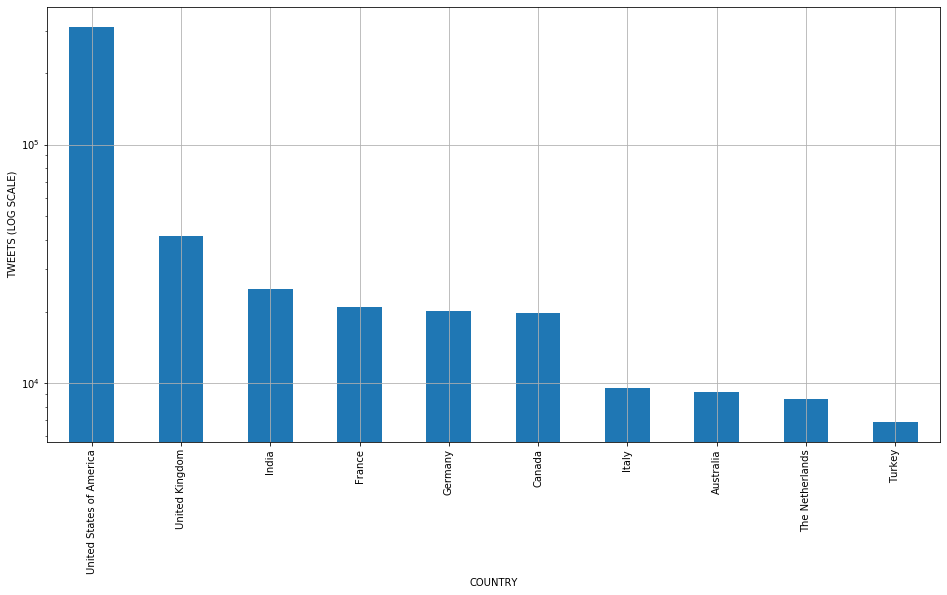

In [247]:
# Top ten countries that tweeted
ax = df.country.value_counts()[:10].plot(kind="bar",figsize=(16,8),logy=True,grid=True)
ax.set_xlabel("COUNTRY")
ax.set_ylabel("TWEETS (LOG SCALE)")


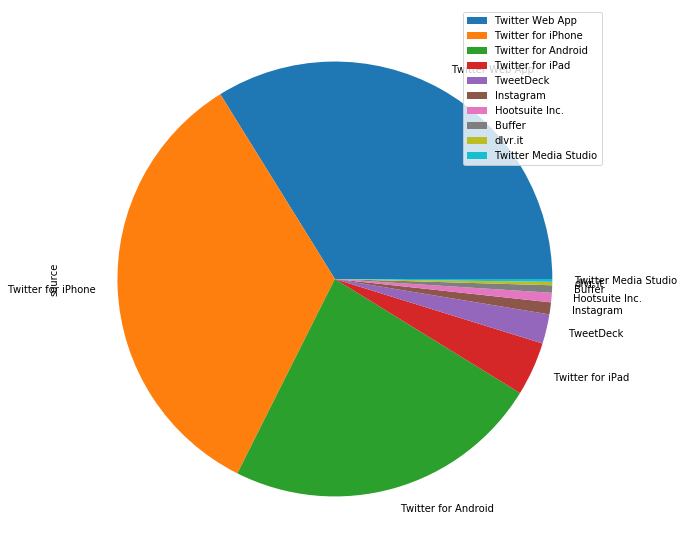

In [248]:
# Top 10 sources of tweets
df.source.value_counts()[:10].plot(kind="pie",figsize=(10, 10),legend=True)

In [249]:
m = folium.Map([37.0902, -95.7129], zoom_start=4)
data = df[['lat', 'long']].as_matrix()[:1900]

popups = df["tweet"].tolist()[:1900]
# plot heatmap
# m.add_children(plugins.HeatMap(data, radius=10,scale_radius=True,blur=10))
plugins.MarkerCluster(data, popups=popups).add_to(m)
m

In [250]:
m = folium.Map([37.0902, -95.7129], zoom_start=4)
data = df[['lat', 'long']].as_matrix()
# plot heatmap
m.add_children(plugins.HeatMap(data, radius=10,scale_radius=True,blur=10))
m